In [3]:
import pandas as pd
import numpy as np
import geopandas as gpd
import warnings
import concurrent.futures
import pickle
warnings.filterwarnings('ignore', message='.*unary_union.*')

lodes = pd.read_csv("data/LODES.csv", low_memory=False)
census = pd.read_csv("data/Decennial_Census.csv")
shapes = gpd.read_file("data/tract_shapefiles/il_t_2020_bound.shp")

lodes["workplace_tract_code"] = lodes["workplace_block_code"].apply(lambda x: str(x)[:11])
lodes["home_tract_code"] = lodes["home_block_code"].apply(lambda x: str(x)[:11])

lodes.drop("Unnamed: 0", axis=1, inplace=True)
census.drop("Unnamed: 0", axis=1, inplace=True)
shapes = shapes[['STATEFP20', 'COUNTYFP20', 'TRACTCE20', 'GEOID20', 'geometry']]
shapes = shapes.to_crs(epsg=3435)
census["tract_code"] = census["geo_id"].apply(lambda x: x[-11:])
census["population"] = census["white"] + census["black"] + census["asian"] + census["american_indian_alaska_native"] + census["pacific_islander"] + census["other_race"] + census["multiracial"] + census["hispanic_latino"]

In [ ]:
import random
from shapely.geometry import Polygon
from shapely.ops import unary_union
import networkx as nx
import numpy as np
random.seed(39)
from concurrent.futures import ProcessPoolExecutor, as_completed
import copy
from copy import deepcopy
import os 
import time
from redistricting_utils import evaluate_proposal
from shapely.geometry import Point

class ILRedistricting:
    def __init__(self, census_df, shapes_df, lodes_df, n_districts=17):
        '''Initializes the redistricting object.'''
        self.census = census_df.copy()
        self.shapes = shapes_df.copy()
        self.lodes = lodes_df.copy()
        self.n_districts = n_districts

        self.data = self.census.merge(
            self.shapes[['GEOID20', 'geometry']], 
            left_on='tract_code', right_on='GEOID20', 
            how='left'
        ).drop(columns=['GEOID20'])
        
        self.data = gpd.GeoDataFrame(self.data, geometry='geometry')
        self.data.set_crs(epsg=3435, inplace=True)

        self.block_to_idx = dict(zip(self.data['tract_code'], range(len(self.data))))
        self.graph = self._create_block_graph()

    def _initialize_lodes_scores(self, districts):
        """
        Compute initial LODES scores for all districts from scratch.
        """
        #HYPERPARAMETERS 
        liveandworkratio = 2/3

        print("Calculating initial LODES scores.")  # To make sure it's goten to here 
        lodes_scores = {}
        for district_idx, district in enumerate(districts):
            tracts = set(district)
            district_lodes = self.lodes[
                self.lodes['workplace_tract_code'].isin(tracts) |
                self.lodes['home_tract_code'].isin(tracts)
            ]

            total_live_in = district_lodes[district_lodes['home_tract_code'].isin(tracts)]['total_jobs'].sum()
            total_work_in = district_lodes[district_lodes['workplace_tract_code'].isin(tracts)]['total_jobs'].sum()
            live_and_work_in = district_lodes[
                (district_lodes['workplace_tract_code'].isin(tracts)) &
                (district_lodes['home_tract_code'].isin(tracts))
            ]['total_jobs'].sum()

            percentage_live_and_work = (live_and_work_in / total_live_in) * 100 if total_live_in > 0 else 0
            percentage_work_and_live = (live_and_work_in / total_work_in) * 100 if total_work_in > 0 else 0

            #district score is weighted towards those who live in a district working in that district - discussed in paper
            district_score = (liveandworkratio * percentage_live_and_work) + ((1-liveandworkratio) * percentage_work_and_live)
            lodes_scores[district_idx] = district_score / 100

        print("Initial LODES scores calculated.") # To make sure it's gotten to here
        return lodes_scores
    
    def _create_block_graph(self): # Initializes tracts as a block graph in accordance with Fifeld et al. (2024) - more discussion in readme + paper
        '''Initializes graph of census tracts.'''
        graph = nx.Graph()
        for idx, row in self.data.iterrows():
            graph.add_node(row['tract_code'], geometry=row['geometry'])
        
        for idx, row in self.data.iterrows():
            possible_neighbors = self.data.sindex.query(row['geometry'], predicate='intersects')
            for neighbor_idx in possible_neighbors:
                if idx != neighbor_idx:
                    neighbor_geom = self.data.iloc[neighbor_idx]['geometry']
                    if row['geometry'].intersection(neighbor_geom).length > 0:
                        graph.add_edge(row['tract_code'], self.data.iloc[neighbor_idx]['tract_code'])
        return graph

    def _is_contiguous(self, district): # Contiguity check. Is utilized repeatedly and obsessively through course of algorithm as even one loss of congruity messes up the entire algorithm. 
        '''Verifies contiguity of provided district'''
        if not district:
            return False
        subgraph = self.graph.subgraph(district)
        return nx.is_connected(subgraph)

    def _generate_proposal(self, districts, lodes_scores, max_attempts=10):
        '''Generates proposed new map by swapping a neighboring tract.'''
        for attempt in range(max_attempts): # Max attempts attempts to break infinite loops. This should no longer be a large concern - proposals will be re-attempted if they result in breakage 
            #of congruity. Doing this 10 times in a row is unlikely, but this exists to prevent that. 
            print(f"Attempt {attempt + 1}/{max_attempts}: Generating proposal...") # Logging/info for debugging

            new_districts = [list(district) for district in districts]

            #choose a random district and tract within district
            from_district_idx = random.randint(0, len(new_districts) - 1)
            from_district = new_districts[from_district_idx]
            if not from_district:
                continue

            eligible_tracts = []
            for tract in from_district:
                neighbors = list(self.graph.neighbors(tract))
                external_neighbors = sum(
                    1 for neighbor in neighbors if any(neighbor in d for d in new_districts if d != from_district)
                )
                eligible_tracts.extend([tract] * (external_neighbors ** 2)) # Key insight discussed in paper = we want to overweight tracts with more non-disrict neighbors, as it removes "spindles"
                #and makes districts less scraggly

            if not eligible_tracts:
                continue

            tract_to_move = random.choice(eligible_tracts)
            if tract_to_move not in from_district:
                print(f"Error: tract_to_move {tract_to_move} not found in from_district_idx {from_district_idx}.")
                continue

            neighbors = list(self.graph.neighbors(tract_to_move))
            neighboring_districts = [
                idx for idx, district in enumerate(new_districts)
                if any(neighbor in district for neighbor in neighbors) and idx != from_district_idx
            ]

            if not neighboring_districts:
                continue

            to_district_idx = random.choice(neighboring_districts)
            from_district.remove(tract_to_move)
            new_districts[to_district_idx].append(tract_to_move)

            #verify congruity
            if self._is_contiguous(new_districts[from_district_idx]) and self._is_contiguous(new_districts[to_district_idx]):
                if all(self._is_contiguous(district) for district in new_districts):
                    print(f"Attempt {attempt + 1}: Successfully generated a valid proposal.")
                    return new_districts, tract_to_move, from_district_idx, to_district_idx, lodes_scores

            #revert changes if it doesn't go well
            new_districts[to_district_idx].remove(tract_to_move)
            from_district.append(tract_to_move)

        print(f"Failed to generate a valid contiguous proposal after {max_attempts} attempts.")
        return None, None, None, None, None


    def _evaluate_proposal(self, proposal,lodes_scores=None, tract_to_move=None, from_district_idx=None, to_district_idx=None, weights=None):
        """
        Evaluate the proposal using normalized scores for each metric.
        Each score is normalized to approximately [0,1] range before weighting.
        
        Args:
            proposal: List of districts to evaluate
            lodes_scores: Pre-calculated LODES scores (optional, make sure this is handled properly)
            tract_to_move: Tract that was moved (optional, for incremental updates) --> bugs arise
            from_district_idx: Source district index (optional, for incremental updates) --> bugs arise
            to_district_idx: Target district index (optional, for incremental updates) --> bugs arise
            weights: Dictionary of weights for each metric (optional)
        """
        print(f"Started evaluate_proposal at {time.time()}") # Tracks time it takes to calculate score, as this used to be the longest part of the algo

        #default weights if none provided are equal
        if weights is None:
            weights = {
                'compactness': 1.0,
                'community': 1.0,
                'population': 1.0,
                'vra': 1.0
            }

        ### COMPACTNESS SCORE COMPUTATION
        # Hyperparameters for section, should all be tested empirically + are dependent on scale of particular map utilized! 
        lowerboundscale = 0.1
        upperboundscale = 3.0
        scaling_factor_exp_distance = 0.75
        scaling_factor_distance = 0.00001

        compactness_scores = []

        for district in proposal:
            district_data = self.data[self.data['tract_code'].isin(district)]
            total_population = district_data['population'].sum()
            district_area = district_data.geometry.area.sum()

            if total_population == 0 or district_data.empty:
                compactness_scores.append(0)
                continue

            district_data = district_data.copy()
            district_data['centroid'] = district_data.geometry.centroid

            x_center = np.average(district_data['centroid'].x, weights=district_data['population'])
            y_center = np.average(district_data['centroid'].y, weights=district_data['population'])
            center = Point(x_center, y_center)

            distances = district_data['centroid'].apply(lambda g: g.distance(center))
            mean_squared_distance = np.mean(distances**2) * scaling_factor_distance

            expected_distance = scaling_factor_exp_distance * (district_area ** 0.5)
            lower_bound = lowerboundscale * expected_distance
            upper_bound = upperboundscale * expected_distance

            if mean_squared_distance <= lower_bound:
                compactness_score = 1
            elif mean_squared_distance >= upper_bound:
                compactness_score = 0
            else:
                compactness_score = 1 - (mean_squared_distance - lower_bound) / (upper_bound - lower_bound)

            compactness_scores.append(compactness_score)

            #print(f"District Compactness: {compactness_score:.4f}, "
            #    f"Unweighted Mean Squared Distance: {mean_squared_distance:.2f}, "
            #    f"Expected Distance: {expected_distance:.2f}, "
            #    f"Lower Bound: {lower_bound:.2f}, Upper Bound: {upper_bound:.2f}")

        #harmonic mean to overpenalize lower scores
        compactness_score = len(compactness_scores) / sum(1 / score for score in compactness_scores if score > 0)


        ### LODES SCORE using the aforementioned incremental evaluator
        if tract_to_move is not None and from_district_idx is not None and to_district_idx is not None:
            print("Performing incremental LODES update.")
            lodes_scores = self._evaluate_proposal_incremental(
                proposal, tract_to_move, from_district_idx, to_district_idx, lodes_scores
            )
        elif lodes_scores is None:
            raise ValueError("LODES scores must not be None during the initial evaluation.")
        
        community_score = np.mean(list(lodes_scores.values()))
        print(f"Community Preservation recalculated: {community_score:.4f}")

        ### POPULATION PARITY SCORE SECTION BELOW:
        district_populations = np.array([
            self.data[self.data['tract_code'].isin(district)]['population'].sum()
            for district in proposal
        ])
        target_population = district_populations.mean()

        quartic_deviations = ((district_populations - target_population) ** 4).sum()

        population_score = 1 - min(quartic_deviations / self.max_possible_quartic, 1)

        ### VRA COMPLIANCE SCORE SECTION BELOW:
        # Hyperparameters for Section
        target_majority_districts = 2  # Target number of majority-minority districts, adjust as necessary

        district_hispanic_pop = [
            self.data[self.data['tract_code'].isin(district)]['hispanic_latino'].sum() 
            for district in proposal
        ]
        district_black_pop = [
            self.data[self.data['tract_code'].isin(district)]['black'].sum() 
            for district in proposal
        ]
        
        hispanic_percentages = [h / t for h, t in zip(district_hispanic_pop, district_populations)]
        black_percentages = [b / t for b, t in zip(district_black_pop, district_populations)]
        
        hispanic_majority = sum(1 for pct in hispanic_percentages if pct > 0.5)
        black_majority = sum(1 for pct in black_percentages if pct > 0.5)
        
        vra_score = (min(hispanic_majority, target_majority_districts) + 
                    min(black_majority, target_majority_districts)) / (2 * target_majority_districts)

        #given provided weights
        total_score = (
            weights['compactness'] * compactness_score +
            weights['community'] * community_score +
            weights['population'] * population_score +
            weights['vra'] * vra_score
        ) / sum(weights.values())  #normalize by sum of weights

        print(
            f"Compactness: {compactness_score:.4f}, "
            f"Community Preservation: {community_score:.4f}, "
            f"Population Parity: {population_score:.4f}, "
            f"VRA Score: {vra_score:.4f}, "
            f"Total Score: {total_score:.4f}"
        )

        return total_score, compactness_score, community_score, population_score, vra_score
    
    def _evaluate_proposal_incremental(self, proposal, tract_to_move, from_district_idx, to_district_idx, previous_scores):
        """
        Incrementally update the LODES scores for the affected districts.
        """
        if previous_scores is None:
            raise ValueError("previous_scores must not be None for incremental updates.")

        print(f"Updating LODES scores for districts {from_district_idx} and {to_district_idx}.")

        # Cannot emphasize enough how important it is there are no errors here. Single error in handling can cause entire algorithm to degenerate from error point forward.

        #create copy of scores
        current_scores = deepcopy(previous_scores)

        #update the from index
        from_district_tracts = set(proposal[from_district_idx])
        district_lodes = self.lodes[
            self.lodes['workplace_tract_code'].isin(from_district_tracts) |
            self.lodes['home_tract_code'].isin(from_district_tracts)
        ]
        total_live_in = district_lodes[district_lodes['home_tract_code'].isin(from_district_tracts)]['total_jobs'].sum()
        total_work_in = district_lodes[district_lodes['workplace_tract_code'].isin(from_district_tracts)]['total_jobs'].sum()
        live_and_work_in = district_lodes[
            (district_lodes['workplace_tract_code'].isin(from_district_tracts)) &
            (district_lodes['home_tract_code'].isin(from_district_tracts))
        ]['total_jobs'].sum()

        percentage_live_and_work = (live_and_work_in / total_live_in) * 100 if total_live_in > 0 else 0
        percentage_work_and_live = (live_and_work_in / total_work_in) * 100 if total_work_in > 0 else 0
        current_scores[from_district_idx] = (2 / 3 * percentage_live_and_work + 1 / 3 * percentage_work_and_live) / 100

        #update the to index
        to_district_tracts = set(proposal[to_district_idx])
        district_lodes = self.lodes[
            self.lodes['workplace_tract_code'].isin(to_district_tracts) |
            self.lodes['home_tract_code'].isin(to_district_tracts)
        ]
        total_live_in = district_lodes[district_lodes['home_tract_code'].isin(to_district_tracts)]['total_jobs'].sum()
        total_work_in = district_lodes[district_lodes['workplace_tract_code'].isin(to_district_tracts)]['total_jobs'].sum()
        live_and_work_in = district_lodes[
            (district_lodes['workplace_tract_code'].isin(to_district_tracts)) &
            (district_lodes['home_tract_code'].isin(to_district_tracts))
        ]['total_jobs'].sum()

        percentage_live_and_work = (live_and_work_in / total_live_in) * 100 if total_live_in > 0 else 0
        percentage_work_and_live = (live_and_work_in / total_work_in) * 100 if total_work_in > 0 else 0
        current_scores[to_district_idx] = (2 / 3 * percentage_live_and_work + 1 / 3 * percentage_work_and_live) / 100

        return current_scores

    def _initialize_random_districts(self):
        """
        Generate initial districts that are guaranteed to be contiguous using a flood-fill approach.
        Ensures no districts fall below 20% of the target population.
        Handles contiguity issues incrementally instead of restarting.
        This is one of those functions that you think is going to be extremely trivial to implement.  You realize something is wrong. You change/fix it. 
        Something else is wrong. You change it. Something else is wrong. Before you know it, you've got a Frankenstein monster of a function. 
        """
        # HYPERPARAMETERS FOR FUNCTION
        underpopulatedpercent = 0.2
        donorthreshold = 0.4

        while True:
            total_population = self.data['population'].sum()
            target_population = total_population / self.n_districts

            unassigned_blocks = set(self.data['tract_code'])
            block_populations = dict(zip(self.data['tract_code'], self.data['population']))
            districts = [[] for _ in range(self.n_districts)]
            district_populations = [0] * self.n_districts

            for district_idx in range(self.n_districts): # For each district
                if not unassigned_blocks:
                    break

                seed_block = random.choice(list(unassigned_blocks)) # Randomly chooses an unassigned block as its seed block
                queue = [seed_block]

                while queue:
                    block = queue.pop(0) # Takes the next block inqueue

                    if block not in unassigned_blocks:
                        continue
                    if district_populations[district_idx] + block_populations[block] > target_population * 1.1: # As long as it wouldn't exceed 1.1* target pop, is added
                        continue

                    districts[district_idx].append(block)
                    district_populations[district_idx] += block_populations[block]
                    unassigned_blocks.remove(block)

                    neighbors = list(self.graph.neighbors(block))
                    for neighbor in neighbors:
                        if neighbor in unassigned_blocks:
                            queue.append(neighbor)

            for block in unassigned_blocks: # Force assigns unassigned block
                best_district = None
                max_neighbors = -1

                neighbors = list(self.graph.neighbors(block))
                for district_idx, district in enumerate(districts):
                    neighbor_count = sum(1 for neighbor in neighbors if neighbor in district)
                    if neighbor_count > max_neighbors:
                        max_neighbors = neighbor_count
                        best_district = district_idx

                if best_district is not None:
                    districts[best_district].append(block)
                    district_populations[best_district] += block_populations[block]
                else:
                    min_population_idx = district_populations.index(min(district_populations))
                    districts[min_population_idx].append(block)
                    district_populations[min_population_idx] += block_populations[block]

            # Section below is to force assign blocks to particularly underpopulated districts. As discussed in paper/readme, have an issue where particularly underpopulated blocks would 
            # never grow over time, this fixes/changes it

            underpopulated_threshold = underpopulatedpercent * target_population
            donor_threshold = donorthreshold * target_population
            attempts = {}

            for idx, district in enumerate(districts):
                while district_populations[idx] < underpopulated_threshold:
                    print(f"District {idx} has population below 20% of target. Redistributing neighbors.")

                    neighbors = set(
                        neighbor for block in district
                        for neighbor in self.graph.neighbors(block)
                    )
                    if idx not in attempts:
                        attempts[idx] = set()

                    transferred = False
                    for neighbor in neighbors:
                        if neighbor in attempts[idx]:
                            continue

                        donor_idx = next(
                            (i for i, d in enumerate(districts) if neighbor in d), None
                        )
                        if donor_idx is not None and donor_idx != idx and district_populations[donor_idx] > donor_threshold:
                            districts[donor_idx].remove(neighbor)
                            districts[idx].append(neighbor)
                            district_populations[donor_idx] -= block_populations[neighbor]
                            district_populations[idx] += block_populations[neighbor]

                            if self._is_contiguous(districts[district_idx]) and self._is_contiguous(districts[donor_idx]):
                                transferred = True
                                print(f"Transferred block {neighbor} from District {donor_idx} to District {idx}.")
                                break
                            else:
                                districts[idx].remove(neighbor)
                                districts[donor_idx].append(neighbor)
                                district_populations[donor_idx] += block_populations[neighbor]
                                district_populations[idx] -= block_populations[neighbor]
                                attempts[idx].add(neighbor)

                    if not transferred:
                        print(f"Warning: Unable to fully populate district {idx}. Moving to next district.")
                        break

            if all(self._is_contiguous(district) for district in districts):
                return districts
            else:
                print("Contiguity issues detected in final validation. Restarting generation...")

    def mcmc(self, phase1_iterations=10000, phase2_iterations=15000, phase3_iterations=10000):
        """
        Three-phase MCMC optimization. As configured currently, this:
        Phase 1: Focus on population parity and basic compactness
        Phase 2: Focus on community preservation and VRA compliance
        Phase 3: Final legality check with balanced priorities
        """
        #First set of hyperparameters (weights and temperatures below)
        quarticdeviationsscaler = 1.25 

        districts = self._initialize_random_districts()
        districts_initial = deepcopy(districts)
        total_iterations = phase1_iterations + phase2_iterations + phase3_iterations
        
        #start logging scores
        scores_log = {
            "iteration": [],
            "phase": [],
            "total_score": [],
            "compactness": [],
            "community_preservation": [],
            "population_parity": [],
            "vra_score": [],
            "temperature": [],
        }
        initial_district_populations = np.array([
            self.data[self.data['tract_code'].isin(district)]['population'].sum()
            for district in districts
        ])
        initial_target_population = initial_district_populations.mean()
        initial_quartic_deviations = ((initial_district_populations - initial_target_population) ** 4).sum()

        #defined max possible deviations
        self.max_possible_quartic = quarticdeviationsscaler * initial_quartic_deviations

        #calc initial LODES score
        lodes_scores = self._initialize_lodes_scores(districts)
        
        ### IMPORTANT HYPERPARAMETERS
        def get_weights(iteration): 
            """
            Determine weights based on current phase and iteration
            Returns dict of weights for each scoring component
            """
            if iteration < phase1_iterations:  #this is for phase 1
                return {
                    'compactness': 1.0,
                    'community': 0.0,
                    'population': 2.0,  #population parity is what we really care about here
                    'vra': 1.0
                }
            elif iteration < (phase1_iterations + phase2_iterations):  #phase 2
                return {
                    'compactness': 1.0,
                    'community': 3.0,  #high weight for community preservation
                    'population': 0.5,  #maintain reasonable population balance
                    'vra': 1.5        #increased focus on VRA compliance
                }
            else:  #this is for phase 3
                return {
                    'compactness': 1.5,  #restored for compliance
                    'community': 0.5,
                    'population': 3.0,  #legal compliance
                    'vra': 1.5        #legal compliance
                }
        
        ### IMPORTANT HYPERPARAMETERS
        def get_temperature(iteration): # Important hyperparameters as well!
            """
            Dynamic temperature schedule that resets at each phase transition
            """
            if iteration < phase1_iterations:
                progress = iteration / phase1_iterations
                T_initial_1, T_final_1 = 0.00002, 0.000002 #we want this temperature to be the lowest, as we want to, for sure have good population and compactness
                return T_initial_1 * ((T_final_1 / T_initial_1) ** progress)
            
            elif iteration < (phase1_iterations + phase2_iterations):
                progress = (iteration - phase1_iterations) / phase2_iterations
                T_initial_2, T_final_2 = 0.0001, 0.00001  #higher temperature for evolution 
                return T_initial_2 * ((T_final_2 / T_initial_2) ** progress)
            
            else:
                progress = (iteration - (phase1_iterations + phase2_iterations)) / phase3_iterations
                T_initial_3, T_final_3 = 0.00005, 0.000005  #lower for final refinement
                return T_initial_3 * ((T_final_3 / T_initial_3) ** progress)
        
        best_districts = deepcopy(districts)
        current_score, _, _, _, _ = self._evaluate_proposal(districts, lodes_scores, weights = get_weights(1))
        best_score = current_score

        for iteration in range(total_iterations):
            print(f"Iteration {iteration}: Phase {1 if iteration < phase1_iterations else 2 if iteration < phase1_iterations + phase2_iterations else 3}")

            if iteration == phase1_iterations or iteration == (phase1_iterations + phase2_iterations):
                print(f"Transitioning to Phase {2 if iteration == phase1_iterations else 3}")

                print(f"Old Current Score: {current_score:.4f} before Phase Transition")

                #update weights for the new phase
                current_weights = get_weights(iteration)
                
                #recalculate the current score using the new phase weights
                current_score, _, _, _, _ = self._evaluate_proposal(districts, lodes_scores, weights=current_weights)
                
                #reset best_score and best_districts to current score and districts
                best_score = current_score
                best_districts = deepcopy(districts)
                print(f"Updated Current Score: {best_score:.4f} after Phase Transition")

            new_districts, tract_to_move, from_district_idx, to_district_idx, _ = self._generate_proposal(districts, lodes_scores)
            
            if new_districts is None:
                print(f"Iteration {iteration}: Proposal generation failed. Skipping.")
                continue
            
            lodes_scores = self._evaluate_proposal_incremental(
                new_districts, tract_to_move, from_district_idx, to_district_idx, lodes_scores
            )
            
            current_weights = get_weights(iteration)
            new_score, compactness, community_preservation, population_parity, vra_score = self._evaluate_proposal(
                new_districts, lodes_scores, weights=current_weights
            )
            
            T = get_temperature(iteration)
            
            current_phase = 1 if iteration < phase1_iterations else 2 if iteration < phase1_iterations + phase2_iterations else 3
            scores_log["iteration"].append(iteration)
            scores_log["phase"].append(current_phase)
            scores_log["total_score"].append(new_score)
            scores_log["compactness"].append(compactness)
            scores_log["community_preservation"].append(community_preservation)
            scores_log["population_parity"].append(population_parity)
            scores_log["vra_score"].append(vra_score)
            scores_log["temperature"].append(T)
            
            if new_score > best_score:
                best_districts = deepcopy(new_districts)
                best_score = new_score
                print(f"Iteration {iteration}: New best score {best_score:.4f}")
            
            diff = new_score - current_score
            likelihood = np.exp(diff / T)
            print(f"Score difference: {diff:.6f}, Temperature: {T:.6f}, Likelihood: {likelihood:.6f}")

            if new_score > current_score or random.uniform(0, 1) < np.exp((new_score - current_score) / T):
                districts = new_districts
                print(f"Before update: Current Score = {current_score}, New Score = {new_score}")
                current_score = new_score 
                print(f"After update: Current Score = {current_score}")
                print("Proposal accepted. Likelihood of random selection:", np.exp((new_score - current_score) / T))
            
            if iteration == phase1_iterations - 1:
                print("Transitioning to Phase 2: Community and VRA focus")
            elif iteration == phase1_iterations + phase2_iterations - 1:
                print("Transitioning to Phase 3: Legal compliance focus")

        
        return best_districts, districts_initial, scores_log


In [19]:
il_redistricting = ILRedistricting(census, shapes, lodes, n_districts=17)

In [22]:
optimal_districts, districtsinitial, scores_log = il_redistricting.mcmc(
        phase1_iterations=10000,
        phase2_iterations=10000,
        phase3_iterations=15000
    )

District 15 has population below 20% of target. Redistributing neighbors.
Transferred block 17113001106 from District 4 to District 15.
District 15 has population below 20% of target. Redistributing neighbors.
Transferred block 17113001800 from District 4 to District 15.
District 15 has population below 20% of target. Redistributing neighbors.
Transferred block 17113005103 from District 4 to District 15.
District 15 has population below 20% of target. Redistributing neighbors.
Transferred block 17113005104 from District 4 to District 15.
District 15 has population below 20% of target. Redistributing neighbors.
Transferred block 17113005102 from District 4 to District 15.
District 15 has population below 20% of target. Redistributing neighbors.
Transferred block 17113005601 from District 4 to District 15.
District 15 has population below 20% of target. Redistributing neighbors.
Transferred block 17113005800 from District 4 to District 15.
District 15 has population below 20% of target. 

/var/folders/sp/g_s7ldrd28zcjypz0jlzcmhw0000gn/T/ipykernel_48035/1802535848.py:568: RuntimeWarning: overflow encountered in exp
  likelihood = np.exp(diff / T)


Started evaluate_proposal at 1733466808.866807
Community Preservation recalculated: 0.4034
Compactness: 0.7856, Community Preservation: 0.4034, Population Parity: 0.4648, VRA Score: 0.2500, Total Score: 0.4913
Score difference: -0.000031, Temperature: 0.000018, Likelihood: 0.186451
Iteration 349: Phase 1
Attempt 1/10: Generating proposal...
Attempt 1: Successfully generated a valid proposal.
Updating LODES scores for districts 9 and 16.
Started evaluate_proposal at 1733466809.496095
Community Preservation recalculated: 0.4032
Compactness: 0.7855, Community Preservation: 0.4032, Population Parity: 0.4650, VRA Score: 0.2500, Total Score: 0.4914
Iteration 349: New best score 0.4914
Score difference: 0.000044, Temperature: 0.000018, Likelihood: 10.899214
Before update: Current Score = 0.49133256715040624, New Score = 0.49137665205556
After update: Current Score = 0.49137665205556
Proposal accepted. Likelihood of random selection: 1.0
Iteration 350: Phase 1
Attempt 1/10: Generating proposal

/var/folders/sp/g_s7ldrd28zcjypz0jlzcmhw0000gn/T/ipykernel_48035/1802535848.py:568: RuntimeWarning: overflow encountered in exp
  likelihood = np.exp(diff / T)


Started evaluate_proposal at 1733484019.868551
Community Preservation recalculated: 0.4421
Compactness: 0.8369, Community Preservation: 0.4421, Population Parity: 0.9852, VRA Score: 0.5000, Total Score: 0.5676
Score difference: -0.000090, Temperature: 0.000066, Likelihood: 0.254201
Iteration 11812: Phase 2
Attempt 1/10: Generating proposal...
Attempt 1: Successfully generated a valid proposal.
Updating LODES scores for districts 10 and 14.
Started evaluate_proposal at 1733484020.899987
Community Preservation recalculated: 0.4421
Compactness: 0.8372, Community Preservation: 0.4421, Population Parity: 0.9854, VRA Score: 0.5000, Total Score: 0.5677
Iteration 11812: New best score 0.5677
Score difference: 0.000005, Temperature: 0.000066, Likelihood: 1.079255
Before update: Current Score = 0.5677187522465034, New Score = 0.5677237775011298
After update: Current Score = 0.5677237775011298
Proposal accepted. Likelihood of random selection: 1.0
Iteration 11813: Phase 2
Attempt 1/10: Generating

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
def plot_scores(scores_log):
    scores_df = pd.DataFrame(scores_log)
    
    fig, axes = plt.subplots(3, 1, figsize=(15, 20))
    
    #all scores over time
    scores_df.plot(
        x='iteration',
        y=['total_score', 'compactness', 'community_preservation', 
           'population_parity', 'vra_score'],
        ax=axes[0]
    )
    axes[0].set_title('Score Components Over Time')
    axes[0].set_xlabel('Iteration')
    axes[0].set_ylabel('Score')
    axes[0].axvline(x=10000, color='r', linestyle='--', label='Phase 1 End')
    axes[0].axvline(x=25000, color='g', linestyle='--', label='Phase 2 End')
    axes[0].legend()
    
    axes[1].plot(scores_df['iteration'], scores_df['temperature'])
    axes[1].set_title('Temperature Schedule')
    axes[1].set_xlabel('Iteration')
    axes[1].set_ylabel('Temperature')
    axes[1].set_yscale('log')
    
    sns.scatterplot(
        data=scores_df,
        x='compactness',
        y='community_preservation',
        hue='phase',
        ax=axes[2],
        alpha=0.5
    )
    axes[2].set_title('Compactness vs Community Preservation by Phase')
    
    plt.tight_layout()
    plt.show()

ModuleNotFoundError: No module named 'seaborn'

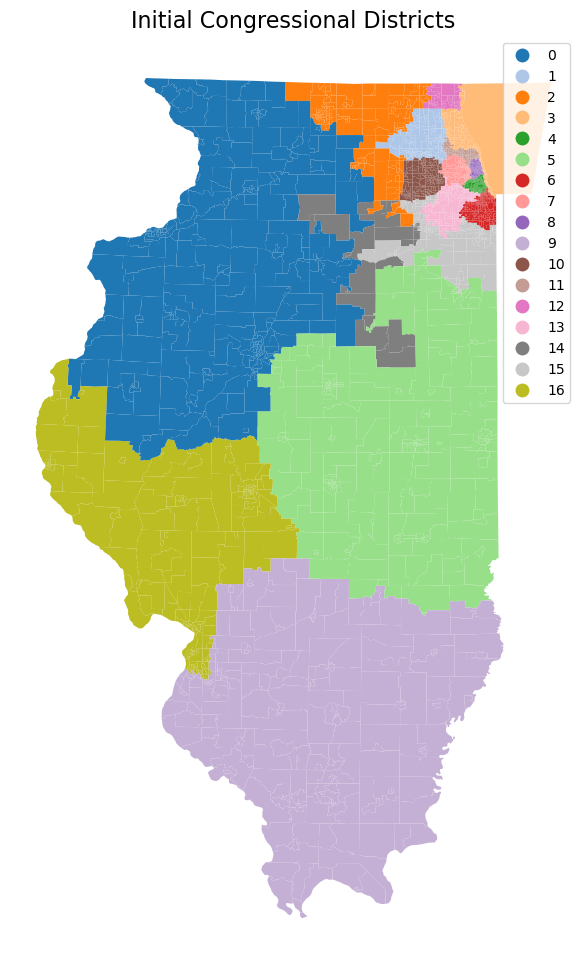

In [25]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

il_redistricting.data['district'] = -1  
for district_number, district in enumerate(districtsinitial):
    il_redistricting.data.loc[
        il_redistricting.data['tract_code'].isin(district), 'district'
    ] = district_number

cmap = mcolors.ListedColormap(plt.cm.tab20.colors[:17])

fig, ax = plt.subplots(figsize=(12, 12))
il_redistricting.data.plot(
    column='district', 
    cmap=cmap, 
    legend=True, 
    categorical=True, 
    ax=ax
)

ax.set_title("Initial Congressional Districts", fontsize=16)
ax.set_axis_off()

plt.show()


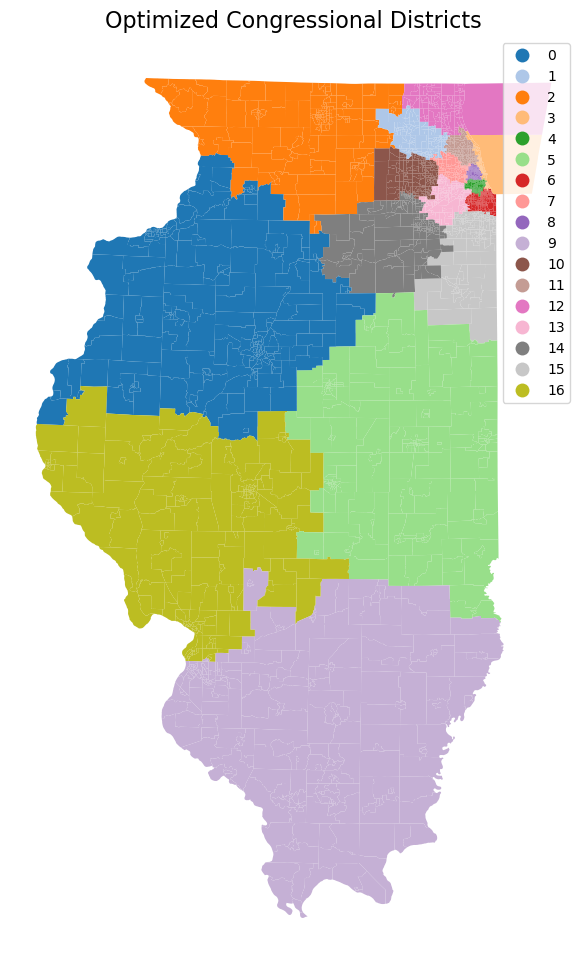

In [ ]:
il_redistricting.data['district'] = -1  
for district_number, district in enumerate(optimal_districts):
    il_redistricting.data.loc[
        il_redistricting.data['tract_code'].isin(district), 'district'
    ] = district_number

cmap = mcolors.ListedColormap(plt.cm.tab20.colors[:17])

fig, ax = plt.subplots(figsize=(12, 12))
il_redistricting.data.plot(
    column='district', 
    cmap=cmap, 
    legend=True, 
    categorical=True, 
    ax=ax
)

ax.set_title("Optimized Congressional Districts", fontsize=16)
ax.set_axis_off()

plt.show()


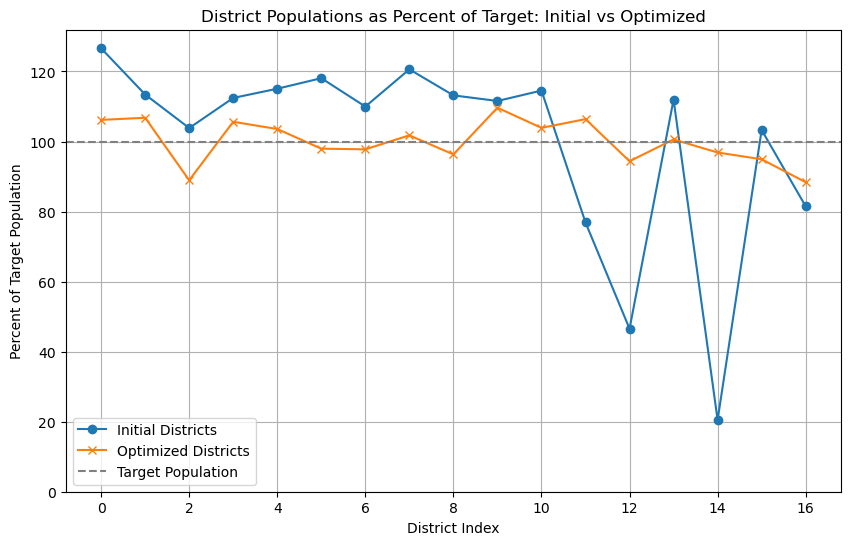

In [ ]:
def calculate_population_percentages(districts, data, target_population):
    return [
        (sum(data[data['tract_code'].isin(district)]['population']) / target_population) * 100
        for district in districts
    ]

target_population = il_redistricting.data['population'].sum() / il_redistricting.n_districts

initial_percentages = calculate_population_percentages(districtsinitial, il_redistricting.data, target_population)
optimized_percentages = calculate_population_percentages(optimal_districts, il_redistricting.data, target_population)

plt.figure(figsize=(10, 6))
plt.plot(initial_percentages, label="Initial Districts", marker='o')
plt.plot(optimized_percentages, label="Optimized Districts", marker='x')
plt.axhline(
    100,  
    color='gray', linestyle='--', label="Target Population"
)

plt.title("District Populations as Percent of Target: Initial vs Optimized")
plt.xlabel("District Index")
plt.ylabel("Percent of Target Population")
plt.ylim(0, None) 
plt.legend()
plt.grid(True)
plt.show()

#the one with deviation is 16


In [ ]:
#Exporting as a shapefile

il_redistricting.data['district'] = -1 
for district_number, district in enumerate(optimal_districts):
    il_redistricting.data.loc[
        il_redistricting.data['tract_code'].isin(district), 'district'
    ] = district_number


output_path = "output/final2.shp"
il_redistricting.data.to_file(output_path, driver="ESRI Shapefile")

print(f"Shapefile with optimized districts saved to: {output_path}")


Shapefile with optimized districts saved to: output/final2.shp


/var/folders/sp/g_s7ldrd28zcjypz0jlzcmhw0000gn/T/ipykernel_48035/1104550970.py:10: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  il_redistricting.data.to_file(output_path, driver="ESRI Shapefile")
/Users/ababu/miniconda3/envs/m1_env/lib/python3.10/site-packages/pyogrio/raw.py:723: RuntimeWarning: Normalized/laundered field name: 'total_houses' to 'total_hous'
  ogr_write(
/Users/ababu/miniconda3/envs/m1_env/lib/python3.10/site-packages/pyogrio/raw.py:723: RuntimeWarning: Normalized/laundered field name: 'occupied_houses' to 'occupied_h'
  ogr_write(
/Users/ababu/miniconda3/envs/m1_env/lib/python3.10/site-packages/pyogrio/raw.py:723: RuntimeWarning: Normalized/laundered field name: 'vacant_houses' to 'vacant_hou'
  ogr_write(
/Users/ababu/miniconda3/envs/m1_env/lib/python3.10/site-packages/pyogrio/raw.py:723: RuntimeWarning: Normalized/laundered field name: 'hispanic_latino' to 'hispanic_l'
  ogr_write(
/Users/ababu/miniconda3/envs